In [ ]:
import hired

In [1]:
from mixing.audio.audio_widget import AudioWidget


aw = AudioWidget('/Users/thorwhalen/Downloads/coucou_bisou_virginie.wav')
aw


<function IPython.core.display_functions.display(*objs, include=None, exclude=None, metadata=None, transient=None, display_id=None, raw=False, clear=False, **kwargs)>

In [1]:
from mixing.audio.audio_ops import Audio
from IPython.display import Audio as IPythonAudio

# Load the OPUS file
audio = Audio('/Users/thorwhalen/Downloads/message_from_virginie.opus')

# Convert to WAV in memory and display
segment = audio._get_segment()
wf = data=segment.get_array_of_samples()
sr=segment.frame_rate
a = IPythonAudio(data=wf, rate=sr)
a

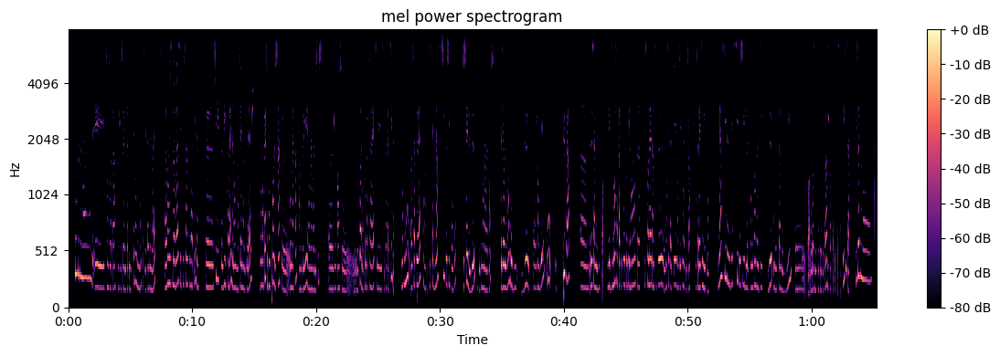

In [2]:
import loopyng

a = loopyng.Sound.from_file('/Users/thorwhalen/Downloads/message_from_virginie.opus')
a.display()

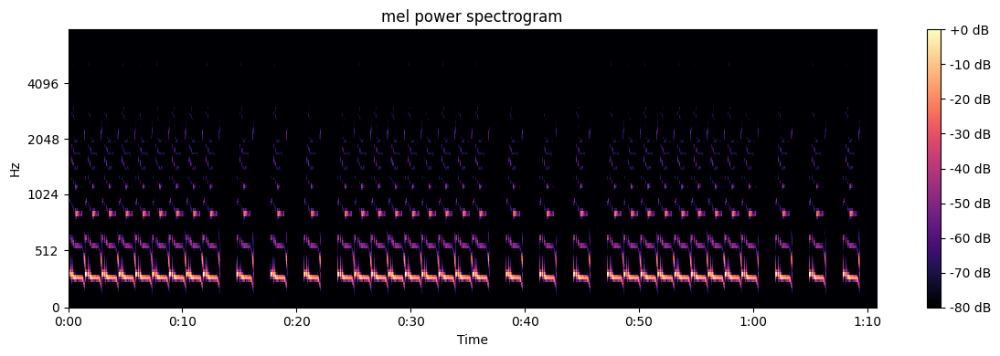

In [3]:
import numpy as np 


aa = a[9000:32600 ]
# aa.display(autoplay=True)

pace = len(aa.wf)
wff = list(aa.wf)
sil = list(np.zeros(len(wff)))

w1 = np.hstack([
    wff, wff, wff, wff,
    wff, wff, wff, wff,
    wff, sil, wff, sil,
    wff, sil, wff, sil,
    wff, wff, wff, wff,
    wff, wff, wff, wff,
    wff, sil, wff, sil,
    wff, sil, wff, sil,
    wff, wff, wff, wff,
    wff, wff, wff, wff,
    wff, sil, wff, sil,
    wff, sil, wff, sil,
])
aa = loopyng.Sound(wf=w1, sr=aa.sr)
aa.display(autoplay=True)

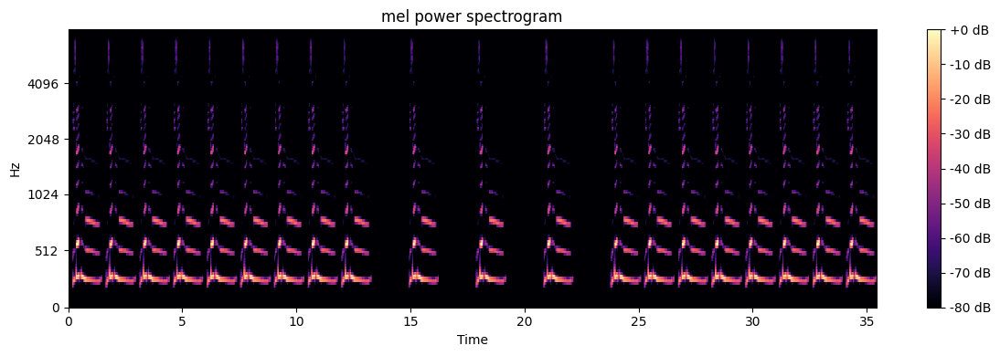

In [4]:
import numpy as np 

x = 6000
aa = a[-(pace+x):-x ]
# aa.display(autoplay=True)

wff = list(aa.wf)
sil = list(np.zeros(len(wff)))

w2 = np.hstack([
    wff, wff, wff, wff,
    wff, wff, wff, wff,
    wff, sil, wff, sil,
    wff, sil, wff, sil,
    wff, wff, wff, wff,
    wff, wff, wff, wff,
])
aa = loopyng.Sound(wf=w2, sr=aa.sr)
aa.display(autoplay=True)


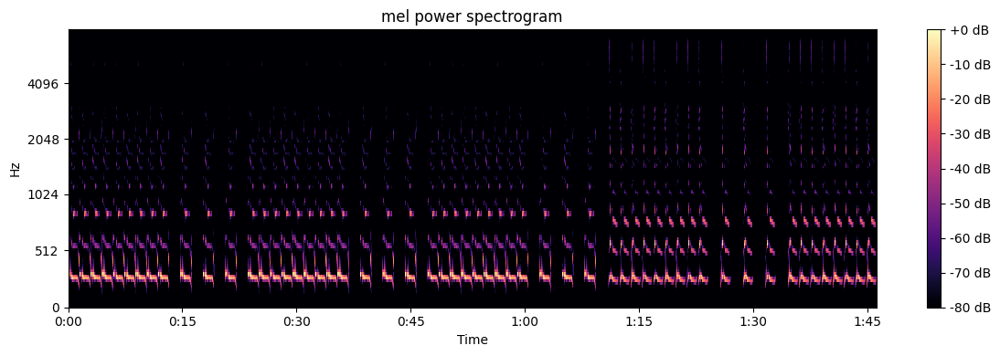

In [5]:
w3 = np.array(list(w1) + list(w2))
t = loopyng.Sound(wf=w3, sr=aa.sr)
t.display(autoplay=True)


In [6]:
t.save_to_wav('/Users/thorwhalen/Downloads/coucou_bisou_virginie.wav')

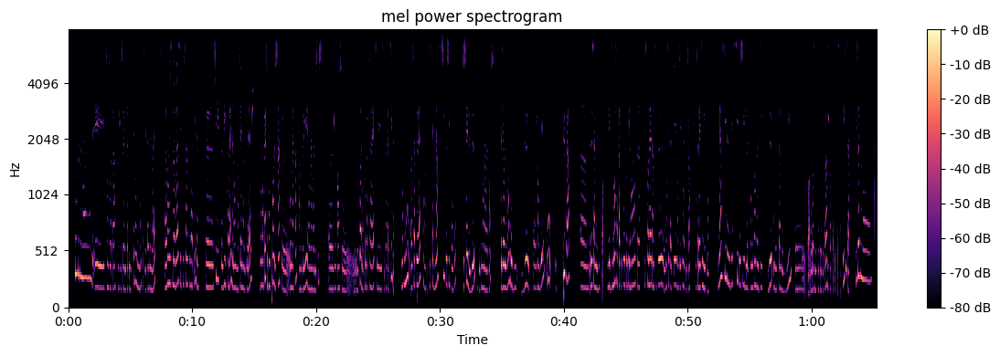

In [7]:
a.display()

In [ ]:
# a.save_to_wav('/Users/thorwhalen/Downloads/message_virginie.wav')

In [100]:
np.mean(np.abs(w3))

np.float64(2668.6575211864406)

In [9]:
talk_wf = a.wf

In [8]:
w3_normalized = w3.astype(np.float32) / 32768.0
loopyng.Sound(wf=w3_normalized, sr=aa.sr).save_to_wav('/Users/thorwhalen/Downloads/coucou_bisou_virginie.wav')

In [10]:
# load the accompaniment waveform, then overlay it with the talk_wf, with a factor of importance for the talk_wf
accompaniment_file = '/Users/thorwhalen/Downloads/coucou_bisou_virginie (Cover) (3).mp3'

accompaniment_wf, accompaniment_sr = loopyng.Sound.from_file(accompaniment_file).wf, loopyng.Sound.from_file(accompaniment_file).sr

# resample accompaniment_wf to match talk_wf sr (48000)

talk_wf_factor = 0.3 # (meaning the proportion of the total volume contribution)




In [ ]:
# save as

In [23]:
import librosa
import numpy as np
import soundfile as sf

accompaniment_file = '/Users/thorwhalen/Downloads/coucou_bisou_virginie (Cover) (6).mp3'
talk_file = '/Users/thorwhalen/Downloads/message_virginie.wav'
save_file = '/Users/thorwhalen/Downloads/coucou_bisou_virginie.wav'
talk_wf_factor = 0.2


def _load_and_normalize(filepath, target_sr=None):
    """Load audio, convert to mono, resample, and normalize to [-1, 1]."""
    wf, sr = librosa.load(filepath, sr=target_sr, mono=True)
    # Normalize to peak amplitude of 1.0
    peak = np.abs(wf).max()
    if peak > 0:
        wf = wf / peak
    return wf, sr


def mix_audio(
    talk_file,
    accompaniment_file,
    save_file,
    *,
    talk_wf_factor=0.5,
    target_sr=None,
):
    """
    Mix talk and accompaniment audio files with controllable balance.
    
    >>> # mix_audio('talk.wav', 'music.mp3', 'out.wav', talk_wf_factor=0.6)
    """
    # Load talk first to get target sample rate
    talk_wf, sr = _load_and_normalize(talk_file, target_sr=target_sr)
    target_sr = sr
    
    # Load accompaniment at same sample rate
    accompaniment_wf, _ = _load_and_normalize(accompaniment_file, target_sr=target_sr)
    
    # Pad shorter to match longer
    max_len = max(len(talk_wf), len(accompaniment_wf))
    talk_wf = np.pad(talk_wf, (0, max_len - len(talk_wf)))
    accompaniment_wf = np.pad(accompaniment_wf, (0, max_len - len(accompaniment_wf)))
    
    # Mix with specified proportions
    accompaniment_factor = 1.0 - talk_wf_factor
    mixed_wf = (talk_wf_factor * talk_wf) + (accompaniment_factor * accompaniment_wf)
    
    # Normalize to prevent clipping
    peak = np.abs(mixed_wf).max()
    if peak > 1.0:
        mixed_wf = mixed_wf / peak
    
    # Save
    sf.write(save_file, mixed_wf, target_sr)
    return save_file


# Run it
mix_audio(talk_file, accompaniment_file, save_file, talk_wf_factor=talk_wf_factor)
print(f"Saved to {save_file}")

Saved to /Users/thorwhalen/Downloads/coucou_bisou_virginie.wav


# Random stuff